In [1]:
from __future__ import print_function, division
import os
import torch
import pandas as pd
from skimage import io, transform
import numpy as np
import matplotlib.pyplot as plt

# Ignore warnings
import warnings
warnings.filterwarnings("ignore")

plt.ion()   # interactive mode

In [2]:
%load_ext autoreload
%autoreload 2

In [3]:
import sys
sys.path.insert(0, '../')

In [4]:
os.environ['CUDA_VISIBLE_DEVICES'] = '0,1'

# Training using the ResNet topology

In [5]:
from cpe775.networks.resnet import resnet18

In [6]:
net = resnet18(in_shape=(-1, 1, 256, 256), out_shape=(-1, 68, 2))

## Loading the dataset and splitting between train and valid

In [7]:
from cpe775.dataset import FaceLandmarksDataset, CroppedFaceLandmarksDataset
from torch.utils.data.sampler import SubsetRandomSampler
from torchvision.transforms import Compose
from cpe775.transforms import ToTensor, CropFace, ToGray, RandomHorizontalFlip, ToPILImage, RandomCrop, CenterCrop

In [8]:
batch_size = 128
random_seed = 42
valid_size = 0.2
shuffle = True

In [9]:
train_transforms = Compose([
                   ToPILImage(),
                   RandomCrop((224,224)),
                   RandomHorizontalFlip(),
                   ToGray(),
                   ToTensor()
                 ])

transforms = Compose([
                   ToPILImage(),
                   CenterCrop((224,224)),
                   ToGray(),
                   ToTensor()
                 ])

In [10]:
# load the dataset
train_dataset = CroppedFaceLandmarksDataset(data_file='../data/train.npz',
                                            transform=train_transforms)
valid_dataset = CroppedFaceLandmarksDataset(data_file='../data/train.npz',
                                            transform=transforms)

num_train = len(train_dataset)
indices = list(range(num_train))
split = int(np.floor(valid_size * num_train))

if shuffle == True:
    np.random.seed(random_seed)
    np.random.shuffle(indices)

train_idx, valid_idx = indices[split:], indices[:split]

train_sampler = SubsetRandomSampler(train_idx)
valid_sampler = SubsetRandomSampler(valid_idx)

train_loader = torch.utils.data.DataLoader(train_dataset, 
                batch_size=batch_size, sampler=train_sampler, num_workers=4)

valid_loader = torch.utils.data.DataLoader(valid_dataset, 
                batch_size=batch_size, sampler=valid_sampler, num_workers=4)

## Creating the model

In [11]:
net = torch.nn.DataParallel(net)
net = net.cuda()

In [12]:
np.sum([v.numel() for v in net.parameters()])

718072

## Creating the loss function

In [13]:
import torch
from cpe775.criterion import NRMSELoss
from cpe775.model import Model
from cpe775 import callbacks

In [14]:
criterion = NRMSELoss(weight=224)
criterion = criterion.cuda()

In [15]:
optimizer = torch.optim.SGD(net.parameters(), 0.001, momentum=0.9)
model = Model(net, criterion=criterion)
model.set_optimizer(optimizer)

## Training

In [16]:
from torch.optim.lr_scheduler import MultiStepLR
from cpe775 import metrics

In [17]:
callback_list = [
        callbacks.Progbar(print_freq=40),
        callbacks.ModelCheckpoint('../results/resnet/resnet-18-1c-nrmse.pth.tar', 'val_loss', mode='min'),
        callbacks.LearningRateScheduler(MultiStepLR(optimizer, milestones=[500,750], gamma=0.1))
    ]

In [18]:
model.fit_loader(train_loader, 1000, val_loader=valid_loader,
                 callback=callbacks.Compose(callback_list), metrics={'nrmse': NRMSELoss(norm='outer_eyes_distance')})

Epoch: [0][0/20]	Time 3.191 (3.191)	Data 0.222 (0.222)	Train Loss 716.921 (716.921)	Train Nrmse 2.300 (2.300)	
Val: [0/5]	Time 0.275 (0.275)	Data 0.255 (0.255)	Val Loss 29785.584 (29785.584)	Val Nrmse 95.513 (95.513)	
Epoch: [1][0/20]	Time 0.293 (0.293)	Data 0.255 (0.255)	Train Loss 114.897 (114.897)	Train Nrmse 0.368 (0.368)	
Val: [0/5]	Time 0.246 (0.246)	Data 0.224 (0.224)	Val Loss 113.411 (113.411)	Val Nrmse 0.365 (0.365)	
Epoch: [2][0/20]	Time 0.254 (0.254)	Data 0.210 (0.210)	Train Loss 83.842 (83.842)	Train Nrmse 0.268 (0.268)	
Val: [0/5]	Time 0.202 (0.202)	Data 0.179 (0.179)	Val Loss 65.819 (65.819)	Val Nrmse 0.211 (0.211)	
Epoch: [3][0/20]	Time 0.318 (0.318)	Data 0.268 (0.268)	Train Loss 92.768 (92.768)	Train Nrmse 0.297 (0.297)	
Val: [0/5]	Time 0.224 (0.224)	Data 0.204 (0.204)	Val Loss 58.832 (58.832)	Val Nrmse 0.189 (0.189)	
Epoch: [4][0/20]	Time 0.279 (0.279)	Data 0.247 (0.247)	Train Loss 76.210 (76.210)	Train Nrmse 0.243 (0.243)	
Val: [0/5]	Time 0.211 (0.211)	Data 0.186 (0.1

Val: [0/5]	Time 0.239 (0.239)	Data 0.220 (0.220)	Val Loss 52.228 (52.228)	Val Nrmse 0.168 (0.168)	
Epoch: [40][0/20]	Time 0.251 (0.251)	Data 0.219 (0.219)	Train Loss 66.840 (66.840)	Train Nrmse 0.213 (0.213)	
Val: [0/5]	Time 0.222 (0.222)	Data 0.204 (0.204)	Val Loss 60.050 (60.050)	Val Nrmse 0.193 (0.193)	
Epoch: [41][0/20]	Time 0.314 (0.314)	Data 0.270 (0.270)	Train Loss 60.148 (60.148)	Train Nrmse 0.192 (0.192)	
Val: [0/5]	Time 0.212 (0.212)	Data 0.187 (0.187)	Val Loss 53.720 (53.720)	Val Nrmse 0.172 (0.172)	
Epoch: [42][0/20]	Time 0.243 (0.243)	Data 0.206 (0.206)	Train Loss 62.087 (62.087)	Train Nrmse 0.199 (0.199)	
Val: [0/5]	Time 0.222 (0.222)	Data 0.199 (0.199)	Val Loss 64.838 (64.838)	Val Nrmse 0.208 (0.208)	
Epoch: [43][0/20]	Time 0.290 (0.290)	Data 0.255 (0.255)	Train Loss 50.354 (50.354)	Train Nrmse 0.162 (0.162)	
Val: [0/5]	Time 0.212 (0.212)	Data 0.191 (0.191)	Val Loss 47.296 (47.296)	Val Nrmse 0.152 (0.152)	
Epoch: [44][0/20]	Time 0.274 (0.274)	Data 0.235 (0.235)	Train Los

Epoch: [79][0/20]	Time 0.241 (0.241)	Data 0.205 (0.205)	Train Loss 22.590 (22.590)	Train Nrmse 0.073 (0.073)	
Val: [0/5]	Time 0.238 (0.238)	Data 0.216 (0.216)	Val Loss 28.488 (28.488)	Val Nrmse 0.091 (0.091)	
Epoch: [80][0/20]	Time 0.263 (0.263)	Data 0.218 (0.218)	Train Loss 24.087 (24.087)	Train Nrmse 0.077 (0.077)	
Val: [0/5]	Time 0.205 (0.205)	Data 0.181 (0.181)	Val Loss 23.194 (23.194)	Val Nrmse 0.075 (0.075)	
Epoch: [81][0/20]	Time 0.260 (0.260)	Data 0.217 (0.217)	Train Loss 27.621 (27.621)	Train Nrmse 0.088 (0.088)	
Val: [0/5]	Time 0.204 (0.204)	Data 0.183 (0.183)	Val Loss 27.697 (27.697)	Val Nrmse 0.089 (0.089)	
Epoch: [82][0/20]	Time 0.232 (0.232)	Data 0.191 (0.191)	Train Loss 26.993 (26.993)	Train Nrmse 0.087 (0.087)	
Val: [0/5]	Time 0.220 (0.220)	Data 0.199 (0.199)	Val Loss 24.455 (24.455)	Val Nrmse 0.079 (0.079)	
Epoch: [83][0/20]	Time 0.220 (0.220)	Data 0.188 (0.188)	Train Loss 24.322 (24.322)	Train Nrmse 0.078 (0.078)	
Val: [0/5]	Time 0.249 (0.249)	Data 0.227 (0.227)	Val L

Val: [0/5]	Time 0.215 (0.215)	Data 0.186 (0.186)	Val Loss 17.593 (17.593)	Val Nrmse 0.056 (0.056)	
Epoch: [119][0/20]	Time 0.266 (0.266)	Data 0.228 (0.228)	Train Loss 17.704 (17.704)	Train Nrmse 0.057 (0.057)	
Val: [0/5]	Time 0.200 (0.200)	Data 0.175 (0.175)	Val Loss 19.961 (19.961)	Val Nrmse 0.064 (0.064)	
Epoch: [120][0/20]	Time 0.270 (0.270)	Data 0.227 (0.227)	Train Loss 18.365 (18.365)	Train Nrmse 0.059 (0.059)	
Val: [0/5]	Time 0.214 (0.214)	Data 0.195 (0.195)	Val Loss 18.936 (18.936)	Val Nrmse 0.061 (0.061)	
Epoch: [121][0/20]	Time 0.243 (0.243)	Data 0.205 (0.205)	Train Loss 19.372 (19.372)	Train Nrmse 0.062 (0.062)	
Val: [0/5]	Time 0.226 (0.226)	Data 0.203 (0.203)	Val Loss 25.360 (25.360)	Val Nrmse 0.081 (0.081)	
Epoch: [122][0/20]	Time 0.234 (0.234)	Data 0.199 (0.199)	Train Loss 21.655 (21.655)	Train Nrmse 0.069 (0.069)	
Val: [0/5]	Time 0.217 (0.217)	Data 0.195 (0.195)	Val Loss 20.367 (20.367)	Val Nrmse 0.066 (0.066)	
Epoch: [123][0/20]	Time 0.241 (0.241)	Data 0.204 (0.204)	Trai

Epoch: [158][0/20]	Time 0.237 (0.237)	Data 0.203 (0.203)	Train Loss 16.662 (16.662)	Train Nrmse 0.054 (0.054)	
Val: [0/5]	Time 0.225 (0.225)	Data 0.207 (0.207)	Val Loss 15.973 (15.973)	Val Nrmse 0.051 (0.051)	
Epoch: [159][0/20]	Time 0.312 (0.312)	Data 0.270 (0.270)	Train Loss 15.983 (15.983)	Train Nrmse 0.051 (0.051)	
Val: [0/5]	Time 0.206 (0.206)	Data 0.180 (0.180)	Val Loss 16.132 (16.132)	Val Nrmse 0.052 (0.052)	
Epoch: [160][0/20]	Time 0.278 (0.278)	Data 0.240 (0.240)	Train Loss 17.347 (17.347)	Train Nrmse 0.056 (0.056)	
Val: [0/5]	Time 0.223 (0.223)	Data 0.199 (0.199)	Val Loss 17.293 (17.293)	Val Nrmse 0.056 (0.056)	
Epoch: [161][0/20]	Time 0.270 (0.270)	Data 0.227 (0.227)	Train Loss 16.314 (16.314)	Train Nrmse 0.052 (0.052)	
Val: [0/5]	Time 0.200 (0.200)	Data 0.178 (0.178)	Val Loss 15.469 (15.469)	Val Nrmse 0.050 (0.050)	
Epoch: [162][0/20]	Time 0.265 (0.265)	Data 0.225 (0.225)	Train Loss 16.318 (16.318)	Train Nrmse 0.052 (0.052)	
Val: [0/5]	Time 0.222 (0.222)	Data 0.203 (0.203)	

Val: [0/5]	Time 0.209 (0.209)	Data 0.180 (0.180)	Val Loss 15.495 (15.495)	Val Nrmse 0.050 (0.050)	
Epoch: [198][0/20]	Time 0.230 (0.230)	Data 0.194 (0.194)	Train Loss 15.427 (15.427)	Train Nrmse 0.049 (0.049)	
Val: [0/5]	Time 0.209 (0.209)	Data 0.190 (0.190)	Val Loss 15.651 (15.651)	Val Nrmse 0.050 (0.050)	
Epoch: [199][0/20]	Time 0.245 (0.245)	Data 0.204 (0.204)	Train Loss 14.664 (14.664)	Train Nrmse 0.047 (0.047)	
Val: [0/5]	Time 0.236 (0.236)	Data 0.218 (0.218)	Val Loss 17.196 (17.196)	Val Nrmse 0.055 (0.055)	
Epoch: [200][0/20]	Time 0.281 (0.281)	Data 0.238 (0.238)	Train Loss 15.979 (15.979)	Train Nrmse 0.051 (0.051)	
Val: [0/5]	Time 0.223 (0.223)	Data 0.198 (0.198)	Val Loss 16.807 (16.807)	Val Nrmse 0.054 (0.054)	
Epoch: [201][0/20]	Time 0.259 (0.259)	Data 0.225 (0.225)	Train Loss 15.511 (15.511)	Train Nrmse 0.050 (0.050)	
Val: [0/5]	Time 0.219 (0.219)	Data 0.196 (0.196)	Val Loss 17.984 (17.984)	Val Nrmse 0.058 (0.058)	
Epoch: [202][0/20]	Time 0.235 (0.235)	Data 0.199 (0.199)	Trai

Epoch: [237][0/20]	Time 0.244 (0.244)	Data 0.208 (0.208)	Train Loss 13.670 (13.670)	Train Nrmse 0.044 (0.044)	
Val: [0/5]	Time 0.234 (0.234)	Data 0.210 (0.210)	Val Loss 15.315 (15.315)	Val Nrmse 0.049 (0.049)	
Epoch: [238][0/20]	Time 0.225 (0.225)	Data 0.183 (0.183)	Train Loss 14.832 (14.832)	Train Nrmse 0.048 (0.048)	
Val: [0/5]	Time 0.205 (0.205)	Data 0.181 (0.181)	Val Loss 15.794 (15.794)	Val Nrmse 0.051 (0.051)	
Epoch: [239][0/20]	Time 0.244 (0.244)	Data 0.195 (0.195)	Train Loss 16.816 (16.816)	Train Nrmse 0.054 (0.054)	
Val: [0/5]	Time 0.226 (0.226)	Data 0.206 (0.206)	Val Loss 14.130 (14.130)	Val Nrmse 0.045 (0.045)	
Epoch: [240][0/20]	Time 0.242 (0.242)	Data 0.210 (0.210)	Train Loss 13.713 (13.713)	Train Nrmse 0.044 (0.044)	
Val: [0/5]	Time 0.224 (0.224)	Data 0.205 (0.205)	Val Loss 15.033 (15.033)	Val Nrmse 0.048 (0.048)	
Epoch: [241][0/20]	Time 0.256 (0.256)	Data 0.211 (0.211)	Train Loss 14.492 (14.492)	Train Nrmse 0.047 (0.047)	
Val: [0/5]	Time 0.203 (0.203)	Data 0.184 (0.184)	

Val: [0/5]	Time 0.215 (0.215)	Data 0.193 (0.193)	Val Loss 17.157 (17.157)	Val Nrmse 0.055 (0.055)	
Epoch: [277][0/20]	Time 0.280 (0.280)	Data 0.242 (0.242)	Train Loss 14.743 (14.743)	Train Nrmse 0.047 (0.047)	
Val: [0/5]	Time 0.222 (0.222)	Data 0.200 (0.200)	Val Loss 16.418 (16.418)	Val Nrmse 0.052 (0.052)	
Epoch: [278][0/20]	Time 0.298 (0.298)	Data 0.248 (0.248)	Train Loss 14.524 (14.524)	Train Nrmse 0.047 (0.047)	
Val: [0/5]	Time 0.221 (0.221)	Data 0.202 (0.202)	Val Loss 14.705 (14.705)	Val Nrmse 0.047 (0.047)	
Epoch: [279][0/20]	Time 0.247 (0.247)	Data 0.208 (0.208)	Train Loss 13.759 (13.759)	Train Nrmse 0.044 (0.044)	
Val: [0/5]	Time 0.214 (0.214)	Data 0.195 (0.195)	Val Loss 14.397 (14.397)	Val Nrmse 0.046 (0.046)	
Epoch: [280][0/20]	Time 0.250 (0.250)	Data 0.206 (0.206)	Train Loss 13.482 (13.482)	Train Nrmse 0.043 (0.043)	
Val: [0/5]	Time 0.223 (0.223)	Data 0.203 (0.203)	Val Loss 14.451 (14.451)	Val Nrmse 0.046 (0.046)	
Epoch: [281][0/20]	Time 0.254 (0.254)	Data 0.209 (0.209)	Trai

Epoch: [316][0/20]	Time 0.230 (0.230)	Data 0.190 (0.190)	Train Loss 13.380 (13.380)	Train Nrmse 0.043 (0.043)	
Val: [0/5]	Time 0.237 (0.237)	Data 0.213 (0.213)	Val Loss 14.069 (14.069)	Val Nrmse 0.045 (0.045)	
Epoch: [317][0/20]	Time 0.264 (0.264)	Data 0.222 (0.222)	Train Loss 13.658 (13.658)	Train Nrmse 0.044 (0.044)	
Val: [0/5]	Time 0.243 (0.243)	Data 0.224 (0.224)	Val Loss 16.594 (16.594)	Val Nrmse 0.053 (0.053)	
Epoch: [318][0/20]	Time 0.234 (0.234)	Data 0.199 (0.199)	Train Loss 13.894 (13.894)	Train Nrmse 0.045 (0.045)	
Val: [0/5]	Time 0.223 (0.223)	Data 0.199 (0.199)	Val Loss 14.853 (14.853)	Val Nrmse 0.048 (0.048)	
Epoch: [319][0/20]	Time 0.264 (0.264)	Data 0.219 (0.219)	Train Loss 12.816 (12.816)	Train Nrmse 0.041 (0.041)	
Val: [0/5]	Time 0.268 (0.268)	Data 0.249 (0.249)	Val Loss 14.531 (14.531)	Val Nrmse 0.046 (0.046)	
Epoch: [320][0/20]	Time 0.265 (0.265)	Data 0.233 (0.233)	Train Loss 12.969 (12.969)	Train Nrmse 0.042 (0.042)	
Val: [0/5]	Time 0.201 (0.201)	Data 0.179 (0.179)	

Val: [0/5]	Time 0.206 (0.206)	Data 0.182 (0.182)	Val Loss 14.464 (14.464)	Val Nrmse 0.047 (0.047)	
Epoch: [356][0/20]	Time 0.246 (0.246)	Data 0.205 (0.205)	Train Loss 12.894 (12.894)	Train Nrmse 0.042 (0.042)	
Val: [0/5]	Time 0.215 (0.215)	Data 0.192 (0.192)	Val Loss 15.273 (15.273)	Val Nrmse 0.049 (0.049)	
Epoch: [357][0/20]	Time 0.284 (0.284)	Data 0.244 (0.244)	Train Loss 12.929 (12.929)	Train Nrmse 0.042 (0.042)	
Val: [0/5]	Time 0.238 (0.238)	Data 0.210 (0.210)	Val Loss 14.092 (14.092)	Val Nrmse 0.046 (0.046)	
Epoch: [358][0/20]	Time 0.256 (0.256)	Data 0.214 (0.214)	Train Loss 13.245 (13.245)	Train Nrmse 0.042 (0.042)	
Val: [0/5]	Time 0.259 (0.259)	Data 0.240 (0.240)	Val Loss 14.578 (14.578)	Val Nrmse 0.047 (0.047)	
Epoch: [359][0/20]	Time 0.292 (0.292)	Data 0.260 (0.260)	Train Loss 13.198 (13.198)	Train Nrmse 0.042 (0.042)	
Val: [0/5]	Time 0.206 (0.206)	Data 0.187 (0.187)	Val Loss 14.381 (14.381)	Val Nrmse 0.046 (0.046)	
Epoch: [360][0/20]	Time 0.272 (0.272)	Data 0.229 (0.229)	Trai

Epoch: [395][0/20]	Time 0.265 (0.265)	Data 0.223 (0.223)	Train Loss 12.942 (12.942)	Train Nrmse 0.041 (0.041)	
Val: [0/5]	Time 0.222 (0.222)	Data 0.195 (0.195)	Val Loss 15.463 (15.463)	Val Nrmse 0.050 (0.050)	
Epoch: [396][0/20]	Time 0.254 (0.254)	Data 0.215 (0.215)	Train Loss 13.192 (13.192)	Train Nrmse 0.042 (0.042)	
Val: [0/5]	Time 0.264 (0.264)	Data 0.240 (0.240)	Val Loss 17.271 (17.271)	Val Nrmse 0.056 (0.056)	
Epoch: [397][0/20]	Time 0.279 (0.279)	Data 0.239 (0.239)	Train Loss 13.170 (13.170)	Train Nrmse 0.042 (0.042)	
Val: [0/5]	Time 0.276 (0.276)	Data 0.253 (0.253)	Val Loss 14.877 (14.877)	Val Nrmse 0.048 (0.048)	
Epoch: [398][0/20]	Time 0.236 (0.236)	Data 0.200 (0.200)	Train Loss 13.154 (13.154)	Train Nrmse 0.042 (0.042)	
Val: [0/5]	Time 0.203 (0.203)	Data 0.184 (0.184)	Val Loss 13.946 (13.946)	Val Nrmse 0.045 (0.045)	
Epoch: [399][0/20]	Time 0.279 (0.279)	Data 0.240 (0.240)	Train Loss 12.537 (12.537)	Train Nrmse 0.040 (0.040)	
Val: [0/5]	Time 0.226 (0.226)	Data 0.208 (0.208)	

Val: [0/5]	Time 0.220 (0.220)	Data 0.199 (0.199)	Val Loss 14.501 (14.501)	Val Nrmse 0.047 (0.047)	
Epoch: [435][0/20]	Time 0.255 (0.255)	Data 0.212 (0.212)	Train Loss 12.485 (12.485)	Train Nrmse 0.040 (0.040)	
Val: [0/5]	Time 0.251 (0.251)	Data 0.232 (0.232)	Val Loss 14.410 (14.410)	Val Nrmse 0.046 (0.046)	
Epoch: [436][0/20]	Time 0.219 (0.219)	Data 0.186 (0.186)	Train Loss 12.340 (12.340)	Train Nrmse 0.040 (0.040)	
Val: [0/5]	Time 0.209 (0.209)	Data 0.184 (0.184)	Val Loss 14.056 (14.056)	Val Nrmse 0.045 (0.045)	
Epoch: [437][0/20]	Time 0.221 (0.221)	Data 0.188 (0.188)	Train Loss 12.020 (12.020)	Train Nrmse 0.039 (0.039)	
Val: [0/5]	Time 0.213 (0.213)	Data 0.194 (0.194)	Val Loss 13.946 (13.946)	Val Nrmse 0.045 (0.045)	
Epoch: [438][0/20]	Time 0.254 (0.254)	Data 0.221 (0.221)	Train Loss 12.488 (12.488)	Train Nrmse 0.040 (0.040)	
Val: [0/5]	Time 0.229 (0.229)	Data 0.206 (0.206)	Val Loss 15.204 (15.204)	Val Nrmse 0.049 (0.049)	
Epoch: [439][0/20]	Time 0.233 (0.233)	Data 0.194 (0.194)	Trai

Epoch: [474][0/20]	Time 0.249 (0.249)	Data 0.206 (0.206)	Train Loss 12.111 (12.111)	Train Nrmse 0.039 (0.039)	
Val: [0/5]	Time 0.194 (0.194)	Data 0.172 (0.172)	Val Loss 13.956 (13.956)	Val Nrmse 0.045 (0.045)	
Epoch: [475][0/20]	Time 0.247 (0.247)	Data 0.207 (0.207)	Train Loss 12.466 (12.466)	Train Nrmse 0.040 (0.040)	
Val: [0/5]	Time 0.273 (0.273)	Data 0.254 (0.254)	Val Loss 13.674 (13.674)	Val Nrmse 0.044 (0.044)	
Epoch: [476][0/20]	Time 0.282 (0.282)	Data 0.242 (0.242)	Train Loss 12.008 (12.008)	Train Nrmse 0.039 (0.039)	
Val: [0/5]	Time 0.210 (0.210)	Data 0.191 (0.191)	Val Loss 13.967 (13.967)	Val Nrmse 0.045 (0.045)	
Epoch: [477][0/20]	Time 0.244 (0.244)	Data 0.203 (0.203)	Train Loss 12.005 (12.005)	Train Nrmse 0.038 (0.038)	
Val: [0/5]	Time 0.207 (0.207)	Data 0.185 (0.185)	Val Loss 14.473 (14.473)	Val Nrmse 0.046 (0.046)	
Epoch: [478][0/20]	Time 0.230 (0.230)	Data 0.193 (0.193)	Train Loss 12.604 (12.604)	Train Nrmse 0.040 (0.040)	
Val: [0/5]	Time 0.206 (0.206)	Data 0.187 (0.187)	

Val: [0/5]	Time 0.211 (0.211)	Data 0.188 (0.188)	Val Loss 13.730 (13.730)	Val Nrmse 0.044 (0.044)	
Epoch: [514][0/20]	Time 0.264 (0.264)	Data 0.227 (0.227)	Train Loss 11.295 (11.295)	Train Nrmse 0.036 (0.036)	
Val: [0/5]	Time 0.206 (0.206)	Data 0.185 (0.185)	Val Loss 13.028 (13.028)	Val Nrmse 0.042 (0.042)	
Epoch: [515][0/20]	Time 0.245 (0.245)	Data 0.213 (0.213)	Train Loss 11.121 (11.121)	Train Nrmse 0.036 (0.036)	
Val: [0/5]	Time 0.250 (0.250)	Data 0.229 (0.229)	Val Loss 13.749 (13.749)	Val Nrmse 0.044 (0.044)	
Epoch: [516][0/20]	Time 0.285 (0.285)	Data 0.243 (0.243)	Train Loss 11.509 (11.509)	Train Nrmse 0.037 (0.037)	
Val: [0/5]	Time 0.260 (0.260)	Data 0.241 (0.241)	Val Loss 14.402 (14.402)	Val Nrmse 0.046 (0.046)	
Epoch: [517][0/20]	Time 0.244 (0.244)	Data 0.207 (0.207)	Train Loss 11.334 (11.334)	Train Nrmse 0.036 (0.036)	
Val: [0/5]	Time 0.226 (0.226)	Data 0.207 (0.207)	Val Loss 13.115 (13.115)	Val Nrmse 0.042 (0.042)	
Epoch: [518][0/20]	Time 0.230 (0.230)	Data 0.188 (0.188)	Trai

Epoch: [553][0/20]	Time 0.283 (0.283)	Data 0.242 (0.242)	Train Loss 11.084 (11.084)	Train Nrmse 0.036 (0.036)	
Val: [0/5]	Time 0.265 (0.265)	Data 0.246 (0.246)	Val Loss 13.467 (13.467)	Val Nrmse 0.043 (0.043)	
Epoch: [554][0/20]	Time 0.228 (0.228)	Data 0.189 (0.189)	Train Loss 10.929 (10.929)	Train Nrmse 0.035 (0.035)	
Val: [0/5]	Time 0.213 (0.213)	Data 0.187 (0.187)	Val Loss 13.662 (13.662)	Val Nrmse 0.044 (0.044)	
Epoch: [555][0/20]	Time 0.262 (0.262)	Data 0.218 (0.218)	Train Loss 11.470 (11.470)	Train Nrmse 0.037 (0.037)	
Val: [0/5]	Time 0.206 (0.206)	Data 0.186 (0.186)	Val Loss 12.928 (12.928)	Val Nrmse 0.042 (0.042)	
Epoch: [556][0/20]	Time 0.300 (0.300)	Data 0.266 (0.266)	Train Loss 10.944 (10.944)	Train Nrmse 0.035 (0.035)	
Val: [0/5]	Time 0.246 (0.246)	Data 0.224 (0.224)	Val Loss 13.197 (13.197)	Val Nrmse 0.042 (0.042)	
Epoch: [557][0/20]	Time 0.245 (0.245)	Data 0.199 (0.199)	Train Loss 11.255 (11.255)	Train Nrmse 0.036 (0.036)	
Val: [0/5]	Time 0.250 (0.250)	Data 0.228 (0.228)	

Val: [0/5]	Time 0.199 (0.199)	Data 0.178 (0.178)	Val Loss 13.479 (13.479)	Val Nrmse 0.043 (0.043)	
Epoch: [593][0/20]	Time 0.261 (0.261)	Data 0.222 (0.222)	Train Loss 11.078 (11.078)	Train Nrmse 0.035 (0.035)	
Val: [0/5]	Time 0.199 (0.199)	Data 0.175 (0.175)	Val Loss 13.609 (13.609)	Val Nrmse 0.044 (0.044)	
Epoch: [594][0/20]	Time 0.220 (0.220)	Data 0.182 (0.182)	Train Loss 10.785 (10.785)	Train Nrmse 0.035 (0.035)	
Val: [0/5]	Time 0.230 (0.230)	Data 0.211 (0.211)	Val Loss 13.797 (13.797)	Val Nrmse 0.044 (0.044)	
Epoch: [595][0/20]	Time 0.267 (0.267)	Data 0.229 (0.229)	Train Loss 10.791 (10.791)	Train Nrmse 0.035 (0.035)	
Val: [0/5]	Time 0.199 (0.199)	Data 0.179 (0.179)	Val Loss 14.035 (14.035)	Val Nrmse 0.045 (0.045)	
Epoch: [596][0/20]	Time 0.228 (0.228)	Data 0.185 (0.185)	Train Loss 11.201 (11.201)	Train Nrmse 0.036 (0.036)	
Val: [0/5]	Time 0.204 (0.204)	Data 0.176 (0.176)	Val Loss 12.795 (12.795)	Val Nrmse 0.041 (0.041)	
Epoch: [597][0/20]	Time 0.223 (0.223)	Data 0.178 (0.178)	Trai

Epoch: [632][0/20]	Time 0.259 (0.259)	Data 0.227 (0.227)	Train Loss 11.450 (11.450)	Train Nrmse 0.037 (0.037)	
Val: [0/5]	Time 0.222 (0.222)	Data 0.200 (0.200)	Val Loss 13.861 (13.861)	Val Nrmse 0.045 (0.045)	
Epoch: [633][0/20]	Time 0.231 (0.231)	Data 0.193 (0.193)	Train Loss 11.087 (11.087)	Train Nrmse 0.036 (0.036)	
Val: [0/5]	Time 0.229 (0.229)	Data 0.209 (0.209)	Val Loss 13.158 (13.158)	Val Nrmse 0.042 (0.042)	
Epoch: [634][0/20]	Time 0.263 (0.263)	Data 0.221 (0.221)	Train Loss 10.720 (10.720)	Train Nrmse 0.034 (0.034)	
Val: [0/5]	Time 0.218 (0.218)	Data 0.199 (0.199)	Val Loss 13.447 (13.447)	Val Nrmse 0.043 (0.043)	
Epoch: [635][0/20]	Time 0.239 (0.239)	Data 0.199 (0.199)	Train Loss 11.187 (11.187)	Train Nrmse 0.036 (0.036)	
Val: [0/5]	Time 0.218 (0.218)	Data 0.199 (0.199)	Val Loss 13.677 (13.677)	Val Nrmse 0.044 (0.044)	
Epoch: [636][0/20]	Time 0.224 (0.224)	Data 0.182 (0.182)	Train Loss 10.563 (10.563)	Train Nrmse 0.034 (0.034)	
Val: [0/5]	Time 0.202 (0.202)	Data 0.182 (0.182)	

Val: [0/5]	Time 0.237 (0.237)	Data 0.217 (0.217)	Val Loss 13.954 (13.954)	Val Nrmse 0.045 (0.045)	
Epoch: [672][0/20]	Time 0.246 (0.246)	Data 0.211 (0.211)	Train Loss 11.034 (11.034)	Train Nrmse 0.035 (0.035)	
Val: [0/5]	Time 0.239 (0.239)	Data 0.218 (0.218)	Val Loss 13.237 (13.237)	Val Nrmse 0.043 (0.043)	
Epoch: [673][0/20]	Time 0.244 (0.244)	Data 0.209 (0.209)	Train Loss 10.741 (10.741)	Train Nrmse 0.035 (0.035)	
Val: [0/5]	Time 0.233 (0.233)	Data 0.213 (0.213)	Val Loss 13.113 (13.113)	Val Nrmse 0.042 (0.042)	
Epoch: [674][0/20]	Time 0.278 (0.278)	Data 0.239 (0.239)	Train Loss 10.872 (10.872)	Train Nrmse 0.035 (0.035)	
Val: [0/5]	Time 0.217 (0.217)	Data 0.198 (0.198)	Val Loss 12.798 (12.798)	Val Nrmse 0.041 (0.041)	
Epoch: [675][0/20]	Time 0.236 (0.236)	Data 0.196 (0.196)	Train Loss 10.961 (10.961)	Train Nrmse 0.035 (0.035)	
Val: [0/5]	Time 0.220 (0.220)	Data 0.196 (0.196)	Val Loss 13.407 (13.407)	Val Nrmse 0.043 (0.043)	
Epoch: [676][0/20]	Time 0.248 (0.248)	Data 0.214 (0.214)	Trai

Epoch: [711][0/20]	Time 0.255 (0.255)	Data 0.220 (0.220)	Train Loss 10.723 (10.723)	Train Nrmse 0.034 (0.034)	
Val: [0/5]	Time 0.210 (0.210)	Data 0.191 (0.191)	Val Loss 13.723 (13.723)	Val Nrmse 0.044 (0.044)	
Epoch: [712][0/20]	Time 0.246 (0.246)	Data 0.205 (0.205)	Train Loss 11.030 (11.030)	Train Nrmse 0.035 (0.035)	
Val: [0/5]	Time 0.220 (0.220)	Data 0.196 (0.196)	Val Loss 14.108 (14.108)	Val Nrmse 0.045 (0.045)	
Epoch: [713][0/20]	Time 0.227 (0.227)	Data 0.191 (0.191)	Train Loss 10.858 (10.858)	Train Nrmse 0.035 (0.035)	
Val: [0/5]	Time 0.236 (0.236)	Data 0.215 (0.215)	Val Loss 13.250 (13.250)	Val Nrmse 0.043 (0.043)	
Epoch: [714][0/20]	Time 0.228 (0.228)	Data 0.182 (0.182)	Train Loss 10.663 (10.663)	Train Nrmse 0.034 (0.034)	
Val: [0/5]	Time 0.234 (0.234)	Data 0.208 (0.208)	Val Loss 13.877 (13.877)	Val Nrmse 0.045 (0.045)	
Epoch: [715][0/20]	Time 0.239 (0.239)	Data 0.200 (0.200)	Train Loss 10.880 (10.880)	Train Nrmse 0.035 (0.035)	
Val: [0/5]	Time 0.224 (0.224)	Data 0.205 (0.205)	

Val: [0/5]	Time 0.215 (0.215)	Data 0.190 (0.190)	Val Loss 13.560 (13.560)	Val Nrmse 0.044 (0.044)	
Epoch: [751][0/20]	Time 0.226 (0.226)	Data 0.177 (0.177)	Train Loss 10.848 (10.848)	Train Nrmse 0.035 (0.035)	
Val: [0/5]	Time 0.229 (0.229)	Data 0.210 (0.210)	Val Loss 13.271 (13.271)	Val Nrmse 0.043 (0.043)	
Epoch: [752][0/20]	Time 0.276 (0.276)	Data 0.235 (0.235)	Train Loss 10.687 (10.687)	Train Nrmse 0.034 (0.034)	
Val: [0/5]	Time 0.211 (0.211)	Data 0.184 (0.184)	Val Loss 13.036 (13.036)	Val Nrmse 0.042 (0.042)	
Epoch: [753][0/20]	Time 0.259 (0.259)	Data 0.218 (0.218)	Train Loss 10.823 (10.823)	Train Nrmse 0.035 (0.035)	
Val: [0/5]	Time 0.201 (0.201)	Data 0.177 (0.177)	Val Loss 13.473 (13.473)	Val Nrmse 0.043 (0.043)	
Epoch: [754][0/20]	Time 0.270 (0.270)	Data 0.228 (0.228)	Train Loss 10.695 (10.695)	Train Nrmse 0.034 (0.034)	
Val: [0/5]	Time 0.220 (0.220)	Data 0.200 (0.200)	Val Loss 13.420 (13.420)	Val Nrmse 0.043 (0.043)	
Epoch: [755][0/20]	Time 0.250 (0.250)	Data 0.205 (0.205)	Trai

Epoch: [790][0/20]	Time 0.262 (0.262)	Data 0.223 (0.223)	Train Loss 10.973 (10.973)	Train Nrmse 0.035 (0.035)	
Val: [0/5]	Time 0.230 (0.230)	Data 0.206 (0.206)	Val Loss 13.052 (13.052)	Val Nrmse 0.042 (0.042)	
Epoch: [791][0/20]	Time 0.247 (0.247)	Data 0.205 (0.205)	Train Loss 10.706 (10.706)	Train Nrmse 0.035 (0.035)	
Val: [0/5]	Time 0.233 (0.233)	Data 0.210 (0.210)	Val Loss 13.809 (13.809)	Val Nrmse 0.044 (0.044)	
Epoch: [792][0/20]	Time 0.221 (0.221)	Data 0.188 (0.188)	Train Loss 10.607 (10.607)	Train Nrmse 0.034 (0.034)	
Val: [0/5]	Time 0.209 (0.209)	Data 0.187 (0.187)	Val Loss 13.776 (13.776)	Val Nrmse 0.044 (0.044)	
Epoch: [793][0/20]	Time 0.272 (0.272)	Data 0.233 (0.233)	Train Loss 10.690 (10.690)	Train Nrmse 0.034 (0.034)	
Val: [0/5]	Time 0.211 (0.211)	Data 0.186 (0.186)	Val Loss 13.177 (13.177)	Val Nrmse 0.042 (0.042)	
Epoch: [794][0/20]	Time 0.242 (0.242)	Data 0.210 (0.210)	Train Loss 10.935 (10.935)	Train Nrmse 0.035 (0.035)	
Val: [0/5]	Time 0.219 (0.219)	Data 0.192 (0.192)	

Val: [0/5]	Time 0.211 (0.211)	Data 0.189 (0.189)	Val Loss 12.953 (12.953)	Val Nrmse 0.041 (0.041)	
Epoch: [830][0/20]	Time 0.277 (0.277)	Data 0.236 (0.236)	Train Loss 10.970 (10.970)	Train Nrmse 0.035 (0.035)	
Val: [0/5]	Time 0.198 (0.198)	Data 0.173 (0.173)	Val Loss 13.319 (13.319)	Val Nrmse 0.043 (0.043)	
Epoch: [831][0/20]	Time 0.241 (0.241)	Data 0.204 (0.204)	Train Loss 11.286 (11.286)	Train Nrmse 0.036 (0.036)	
Val: [0/5]	Time 0.214 (0.214)	Data 0.190 (0.190)	Val Loss 13.526 (13.526)	Val Nrmse 0.043 (0.043)	
Epoch: [832][0/20]	Time 0.250 (0.250)	Data 0.213 (0.213)	Train Loss 10.551 (10.551)	Train Nrmse 0.034 (0.034)	
Val: [0/5]	Time 0.258 (0.258)	Data 0.239 (0.239)	Val Loss 13.230 (13.230)	Val Nrmse 0.042 (0.042)	
Epoch: [833][0/20]	Time 0.247 (0.247)	Data 0.204 (0.204)	Train Loss 10.420 (10.420)	Train Nrmse 0.033 (0.033)	
Val: [0/5]	Time 0.220 (0.220)	Data 0.196 (0.196)	Val Loss 13.274 (13.274)	Val Nrmse 0.043 (0.043)	
Epoch: [834][0/20]	Time 0.230 (0.230)	Data 0.192 (0.192)	Trai

Epoch: [869][0/20]	Time 0.226 (0.226)	Data 0.184 (0.184)	Train Loss 10.819 (10.819)	Train Nrmse 0.035 (0.035)	
Val: [0/5]	Time 0.212 (0.212)	Data 0.191 (0.191)	Val Loss 12.844 (12.844)	Val Nrmse 0.041 (0.041)	
Epoch: [870][0/20]	Time 0.267 (0.267)	Data 0.233 (0.233)	Train Loss 11.120 (11.120)	Train Nrmse 0.036 (0.036)	
Val: [0/5]	Time 0.218 (0.218)	Data 0.199 (0.199)	Val Loss 13.388 (13.388)	Val Nrmse 0.043 (0.043)	
Epoch: [871][0/20]	Time 0.218 (0.218)	Data 0.183 (0.183)	Train Loss 10.740 (10.740)	Train Nrmse 0.034 (0.034)	
Val: [0/5]	Time 0.239 (0.239)	Data 0.220 (0.220)	Val Loss 13.111 (13.111)	Val Nrmse 0.042 (0.042)	
Epoch: [872][0/20]	Time 0.267 (0.267)	Data 0.226 (0.226)	Train Loss 10.911 (10.911)	Train Nrmse 0.035 (0.035)	
Val: [0/5]	Time 0.213 (0.213)	Data 0.192 (0.192)	Val Loss 13.128 (13.128)	Val Nrmse 0.042 (0.042)	
Epoch: [873][0/20]	Time 0.223 (0.223)	Data 0.184 (0.184)	Train Loss 10.405 (10.405)	Train Nrmse 0.033 (0.033)	
Val: [0/5]	Time 0.238 (0.238)	Data 0.217 (0.217)	

Val: [0/5]	Time 0.209 (0.209)	Data 0.186 (0.186)	Val Loss 13.511 (13.511)	Val Nrmse 0.043 (0.043)	
Epoch: [909][0/20]	Time 0.250 (0.250)	Data 0.212 (0.212)	Train Loss 11.342 (11.342)	Train Nrmse 0.036 (0.036)	
Val: [0/5]	Time 0.201 (0.201)	Data 0.180 (0.180)	Val Loss 13.281 (13.281)	Val Nrmse 0.043 (0.043)	
Epoch: [910][0/20]	Time 0.230 (0.230)	Data 0.191 (0.191)	Train Loss 10.909 (10.909)	Train Nrmse 0.035 (0.035)	
Val: [0/5]	Time 0.202 (0.202)	Data 0.178 (0.178)	Val Loss 12.866 (12.866)	Val Nrmse 0.041 (0.041)	
Epoch: [911][0/20]	Time 0.245 (0.245)	Data 0.213 (0.213)	Train Loss 11.157 (11.157)	Train Nrmse 0.036 (0.036)	
Val: [0/5]	Time 0.206 (0.206)	Data 0.184 (0.184)	Val Loss 13.402 (13.402)	Val Nrmse 0.043 (0.043)	
Epoch: [912][0/20]	Time 0.267 (0.267)	Data 0.216 (0.216)	Train Loss 11.039 (11.039)	Train Nrmse 0.035 (0.035)	
Val: [0/5]	Time 0.217 (0.217)	Data 0.198 (0.198)	Val Loss 12.846 (12.846)	Val Nrmse 0.041 (0.041)	
Epoch: [913][0/20]	Time 0.249 (0.249)	Data 0.211 (0.211)	Trai

Epoch: [948][0/20]	Time 0.275 (0.275)	Data 0.239 (0.239)	Train Loss 10.796 (10.796)	Train Nrmse 0.035 (0.035)	
Val: [0/5]	Time 0.200 (0.200)	Data 0.175 (0.175)	Val Loss 13.023 (13.023)	Val Nrmse 0.042 (0.042)	
Epoch: [949][0/20]	Time 0.265 (0.265)	Data 0.224 (0.224)	Train Loss 10.350 (10.350)	Train Nrmse 0.033 (0.033)	
Val: [0/5]	Time 0.208 (0.208)	Data 0.189 (0.189)	Val Loss 13.491 (13.491)	Val Nrmse 0.043 (0.043)	
Epoch: [950][0/20]	Time 0.232 (0.232)	Data 0.190 (0.190)	Train Loss 10.782 (10.782)	Train Nrmse 0.035 (0.035)	
Val: [0/5]	Time 0.241 (0.241)	Data 0.218 (0.218)	Val Loss 13.528 (13.528)	Val Nrmse 0.044 (0.044)	
Epoch: [951][0/20]	Time 0.243 (0.243)	Data 0.205 (0.205)	Train Loss 10.808 (10.808)	Train Nrmse 0.035 (0.035)	
Val: [0/5]	Time 0.198 (0.198)	Data 0.174 (0.174)	Val Loss 12.986 (12.986)	Val Nrmse 0.042 (0.042)	
Epoch: [952][0/20]	Time 0.230 (0.230)	Data 0.188 (0.188)	Train Loss 10.821 (10.821)	Train Nrmse 0.035 (0.035)	
Val: [0/5]	Time 0.219 (0.219)	Data 0.200 (0.200)	

Val: [0/5]	Time 0.239 (0.239)	Data 0.218 (0.218)	Val Loss 13.419 (13.419)	Val Nrmse 0.043 (0.043)	
Epoch: [988][0/20]	Time 0.237 (0.237)	Data 0.191 (0.191)	Train Loss 10.876 (10.876)	Train Nrmse 0.035 (0.035)	
Val: [0/5]	Time 0.246 (0.246)	Data 0.227 (0.227)	Val Loss 12.782 (12.782)	Val Nrmse 0.041 (0.041)	
Epoch: [989][0/20]	Time 0.242 (0.242)	Data 0.203 (0.203)	Train Loss 10.571 (10.571)	Train Nrmse 0.034 (0.034)	
Val: [0/5]	Time 0.217 (0.217)	Data 0.197 (0.197)	Val Loss 13.708 (13.708)	Val Nrmse 0.044 (0.044)	
Epoch: [990][0/20]	Time 0.249 (0.249)	Data 0.209 (0.209)	Train Loss 10.959 (10.959)	Train Nrmse 0.035 (0.035)	
Val: [0/5]	Time 0.256 (0.256)	Data 0.237 (0.237)	Val Loss 13.302 (13.302)	Val Nrmse 0.043 (0.043)	
Epoch: [991][0/20]	Time 0.234 (0.234)	Data 0.195 (0.195)	Train Loss 10.400 (10.400)	Train Nrmse 0.033 (0.033)	
Val: [0/5]	Time 0.238 (0.238)	Data 0.219 (0.219)	Val Loss 12.738 (12.738)	Val Nrmse 0.041 (0.041)	
Epoch: [992][0/20]	Time 0.235 (0.235)	Data 0.194 (0.194)	Trai

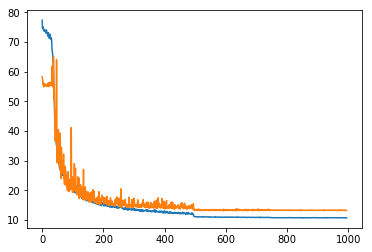

In [19]:
plt.plot(callback_list[1].history['train_loss'][5:])
plt.plot(callback_list[1].history['val_loss'][5:])

In [20]:
checkpoint = torch.load('../results/resnet/resnet-18-1c-nrmse.pth-best.tar')

## Loading the best model

In [35]:
from cpe775.utils.img_utils import show_landmarks_batch

In [36]:
net = resnet18(in_shape=(-1, 1, 256, 256), out_shape=(-1, 68, 2))

In [37]:
best_model = Model(net)
best_net = model.net
best_net.load_state_dict(checkpoint['state_dict'])

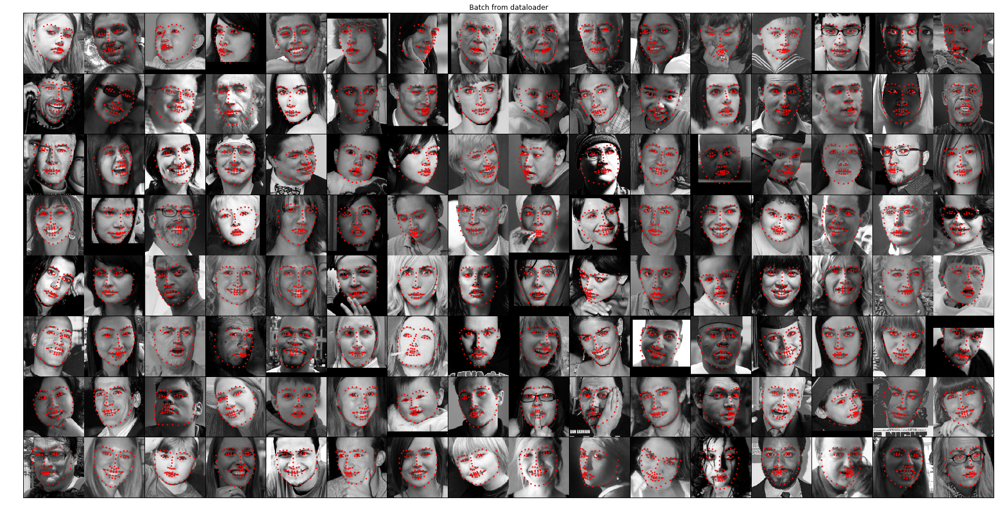

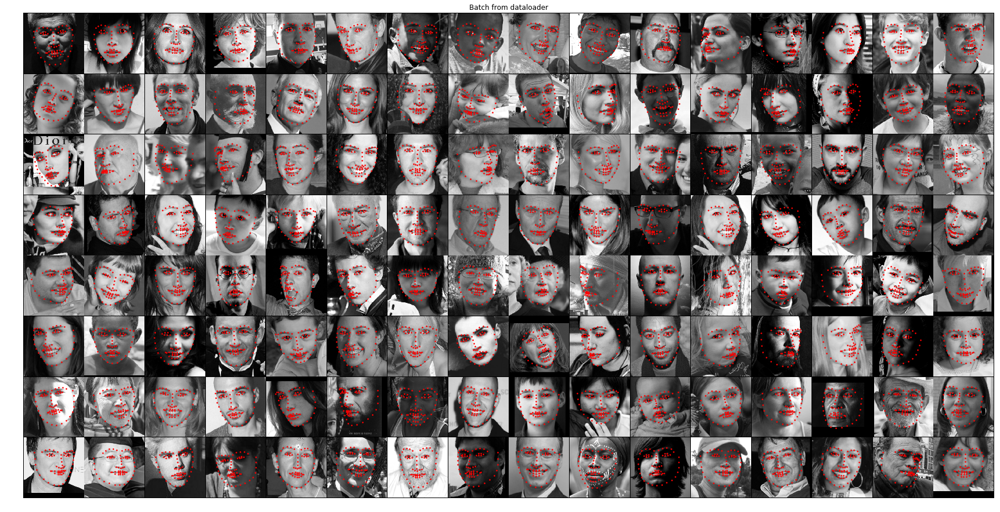

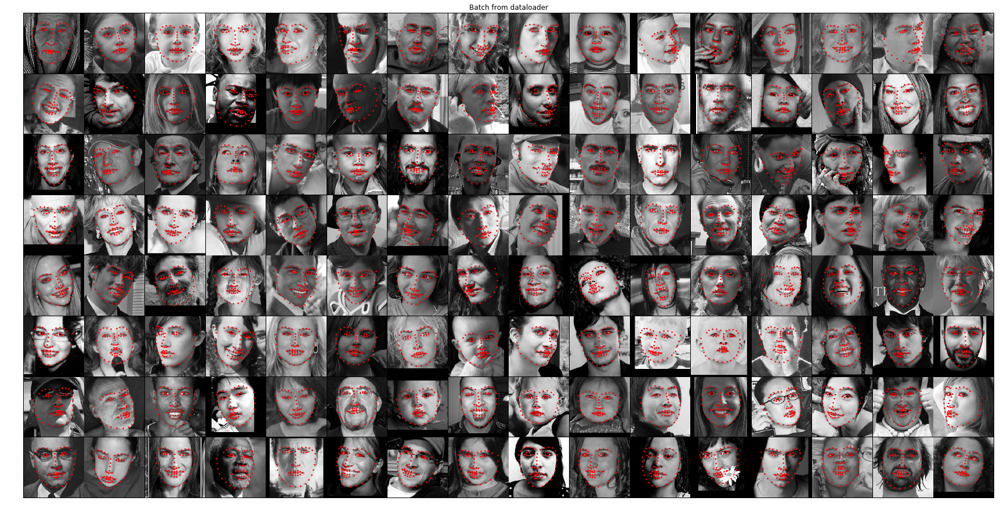

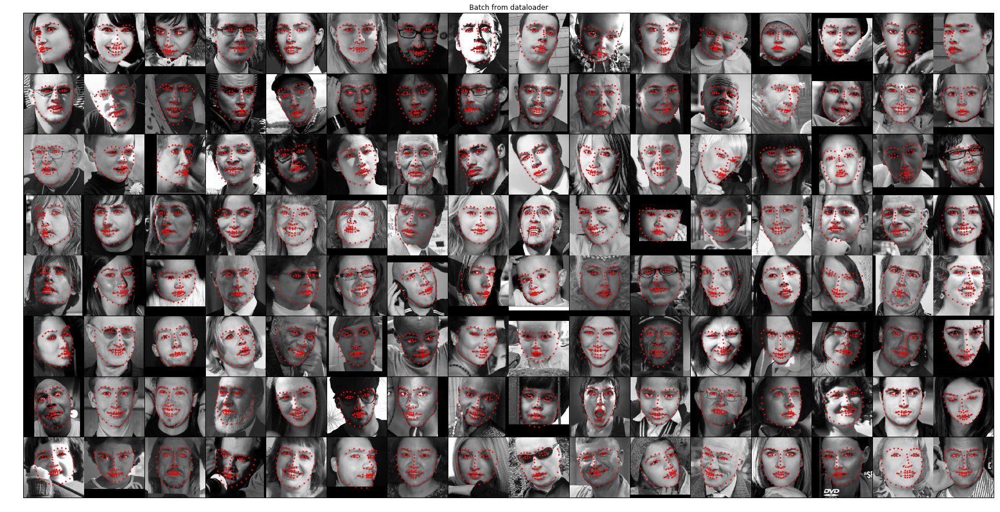

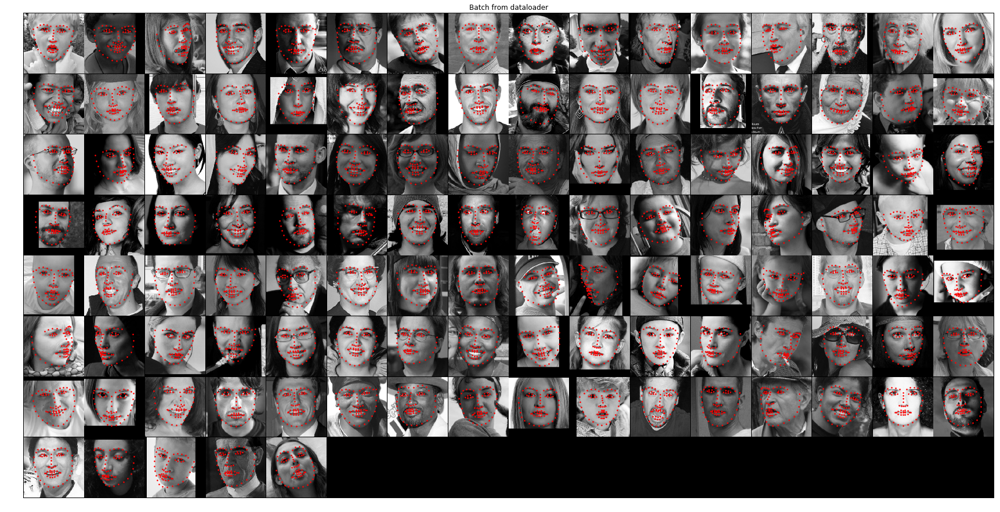

In [24]:
for i_batch, sample_batched in enumerate(valid_loader):
    
    predicted_landmarks = best_net(torch.autograd.Variable(sample_batched['image'], volatile=False)).cpu().data

    
    plt.figure(figsize=(30,18))
    show_landmarks_batch({'image': sample_batched['image'], 'landmarks': predicted_landmarks}, nrow=16)

    plt.axis('off')
    plt.ioff()
    plt.show()

### Common test

In [25]:
transforms = Compose([
                   CropFace(),
                   CenterCrop((224,224)),
                   ToGray(),
                   ToTensor()
                 ])

In [26]:
# load the dataset
dataset = FaceLandmarksDataset(csv_file='../data/common_test.csv',
                               root_dir='../data/',
                               transform=transforms)

common_loader = torch.utils.data.DataLoader(dataset, 
                batch_size=batch_size, num_workers=4)

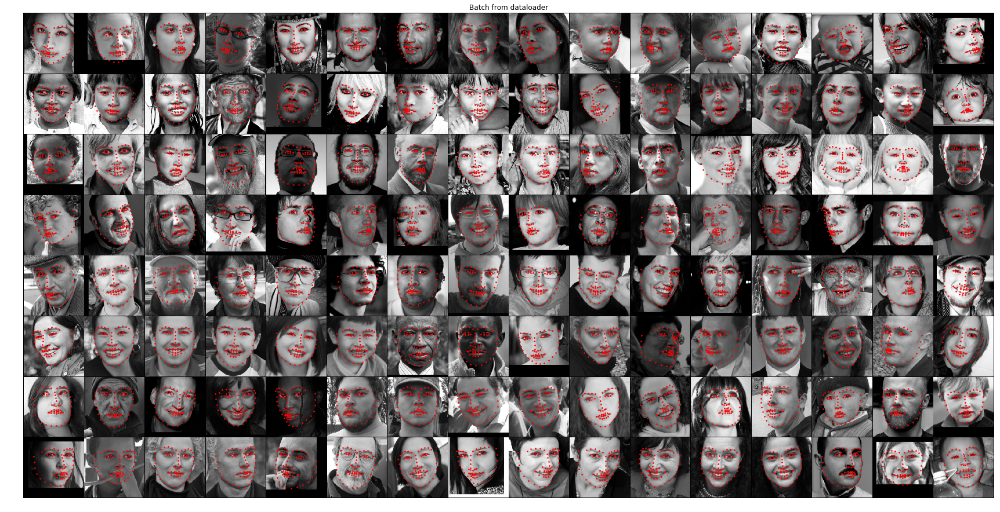

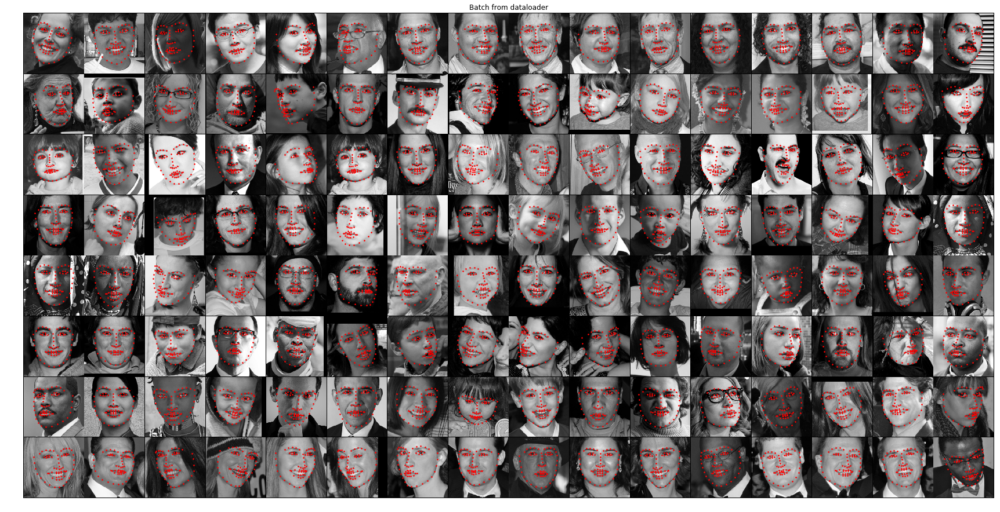

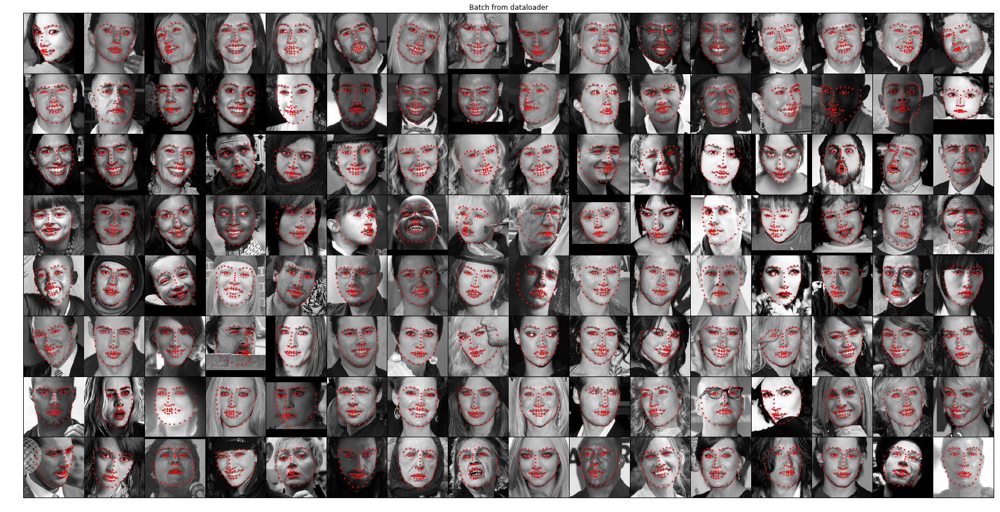

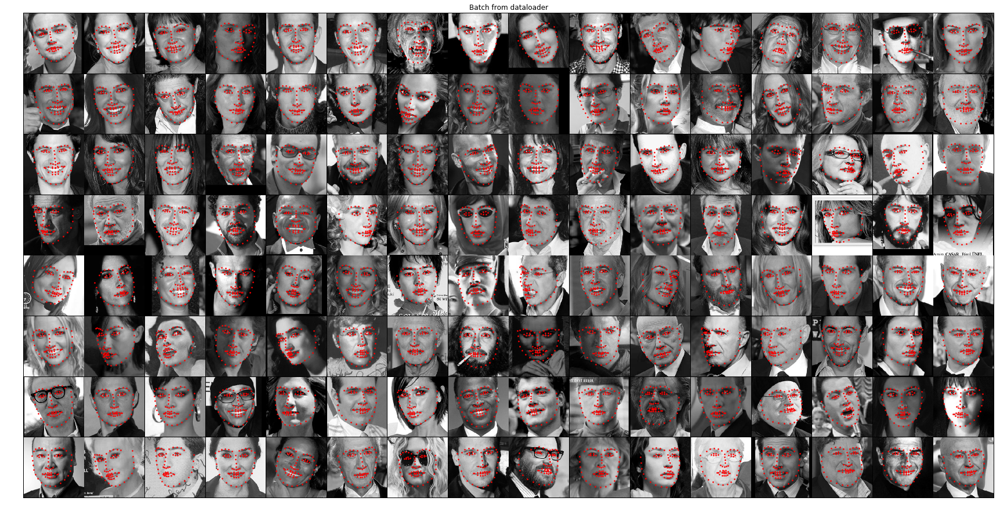

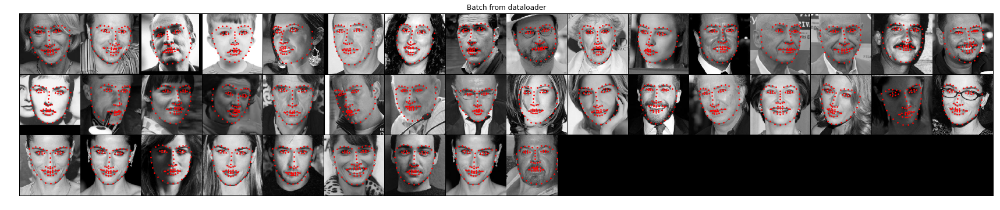

In [27]:
loss = 0
for i_batch, sample_batched in enumerate(common_loader):
    
    predicted_landmarks = best_net(torch.autograd.Variable(sample_batched['image'], volatile=False)).cpu().data
    
    loss += predicted_landmarks.shape[0]*criterion(predicted_landmarks, sample_batched['landmarks'])
    
    plt.figure(figsize=(30,18))
    show_landmarks_batch({'image': sample_batched['image'], 'landmarks': predicted_landmarks}, nrow=16)
    plt.axis('off')
    plt.ioff()
    plt.show()

In [28]:
loss/len(dataset)

12.487246895138222

### Challenging test

In [29]:
# load the dataset
challenging_set = FaceLandmarksDataset(csv_file='../data/challenging_test.csv',
                               root_dir='../data/',
                               transform=transforms)

challeging_loader = torch.utils.data.DataLoader(challenging_set, 
                batch_size=batch_size, num_workers=4)

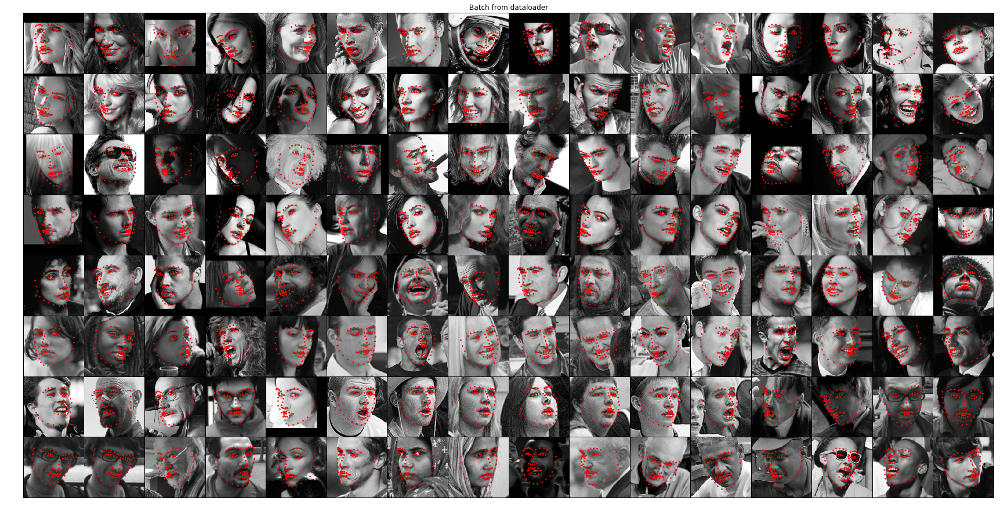

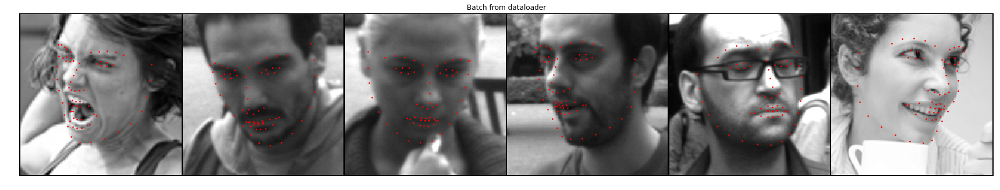

In [30]:
loss = 0
for i_batch, sample_batched in enumerate(challeging_loader):
    
    predicted_landmarks = best_net(torch.autograd.Variable(sample_batched['image'], volatile=False)).cpu().data
    
    loss += predicted_landmarks.shape[0]*criterion(predicted_landmarks, sample_batched['landmarks'])
    
    plt.figure(figsize=(30,18))
    show_landmarks_batch({'image': sample_batched['image'], 'landmarks': predicted_landmarks}, nrow=16)
    plt.axis('off')
    plt.ioff()
    plt.show()

In [31]:
loss/len(challenging_set)

28.740617166704208